# Модуль 8. Временные ряды

In [52]:
import numpy as np, pandas as pd
import matplotlib.pyplot as plt

from scipy import interpolate

import plotly.graph_objects as go
import time, datetime

### Задание 8.6.1

In [6]:
data = pd.read_csv('./data/srt_data.csv')
df = data.copy()
df.head(2)

,ts,serialNo,home,batteryVoltageMilliV,insideTemperatureCentiC,humidityMilliPerc
0,2018-10-01,VA4202760704,165132,2787.1310,1953.0737,575.4918
1,2018-10-02,VA4202760704,165132,2786.1047,1901.0000,550.6371


In [8]:
df1 = df[df.serialNo == 'VA2170620672']
df1.batteryVoltageMilliV.max()

3219.567

### Задание 8.6.2

In [10]:
df1.batteryVoltageMilliV.quantile(q=[0.75])

0.75    2951.2801
Name: batteryVoltageMilliV, dtype: float64

### Задание 8.6.3

In [13]:
df2 = df[(df1.ts >= '2018-11-01') & (df.ts < '2018-12-01')]
df2.humidityMilliPerc.median()

566.3562

### Задание 8.6.4

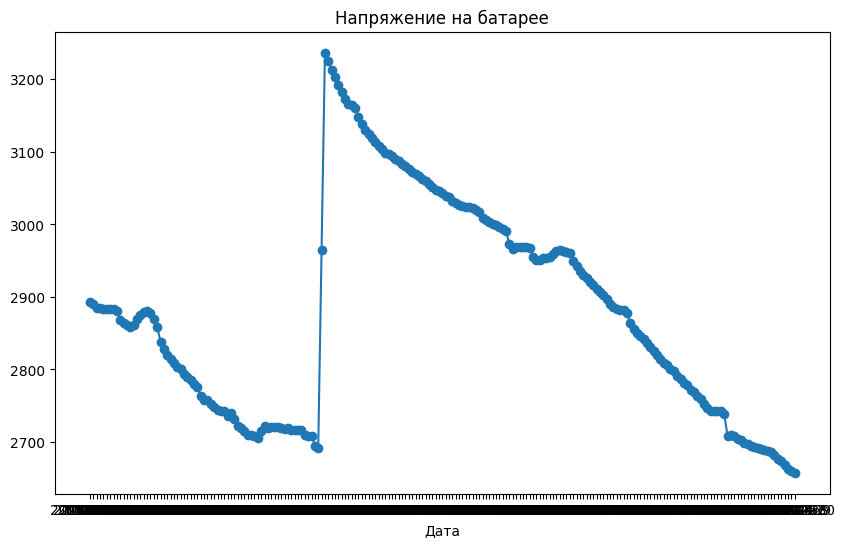

In [16]:
df3 = df[df.serialNo == 'VA2048854528']

# Построение графика напряжения на батарее
plt.figure(figsize=(10, 6))
plt.plot(df3.ts, df3.batteryVoltageMilliV, marker='o', linestyle='-')
plt.title('Напряжение на батарее')
plt.xlabel('Дата')
plt.show()

### Задание 8.6.5

In [18]:
len(df[df.insideTemperatureCentiC < 1200])

92

### Задание 8.6.6

In [30]:
quantile75 = df.insideTemperatureCentiC.quantile(0.75)
len(df[df.insideTemperatureCentiC > quantile75])

1206

### Задание 8.8.1

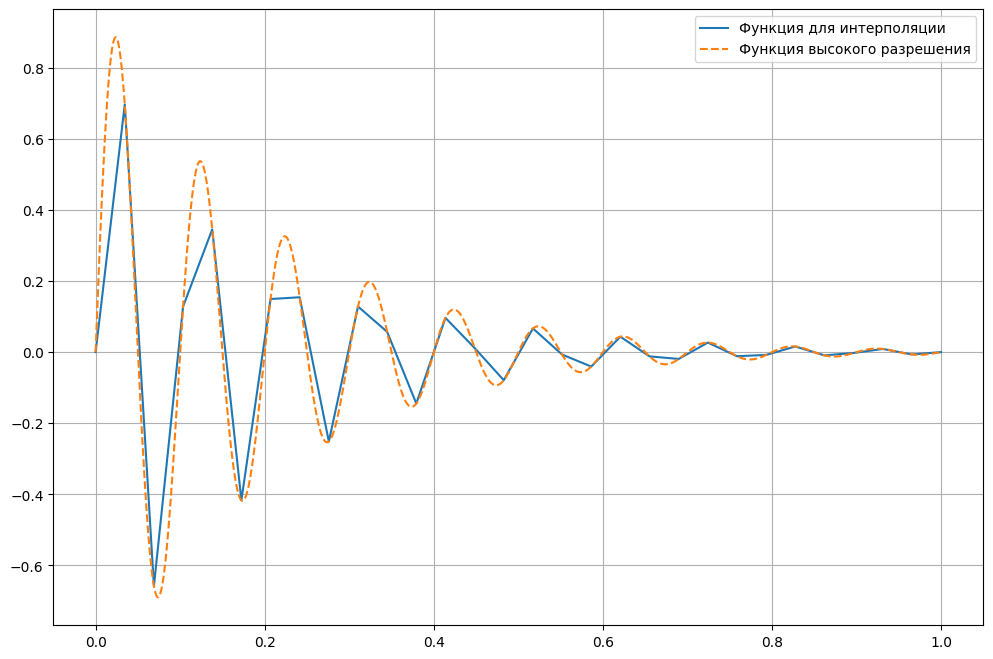

In [33]:
w1 = 10    
a1 = 1     
Fs = 30 
Ts = 1.0/Fs
alpha = 5

## исходная ось (низкое разрешение)
t = np.linspace(0, 1, Fs)
## функция для интерполяции
y = a1*np.exp(-alpha*t) * np.sin(2*np.pi*w1*t) 
 
## интерполяционная сетка (высокое разрешение)
tt = np.linspace(0, 1, 100*Fs)
## функция высокого разрешения (пытаемся получить её интерполяцией)
y_high_res = a1*np.exp(-alpha*tt) * np.sin(2*np.pi*w1*tt) 

f, ax = plt.subplots(figsize=(12, 8))
ax.plot(t, y)
ax.plot(tt, y_high_res, '--')
ax.legend(['Функция для интерполяции', 'Функция высокого разрешения'])
ax.grid()
plt.show()

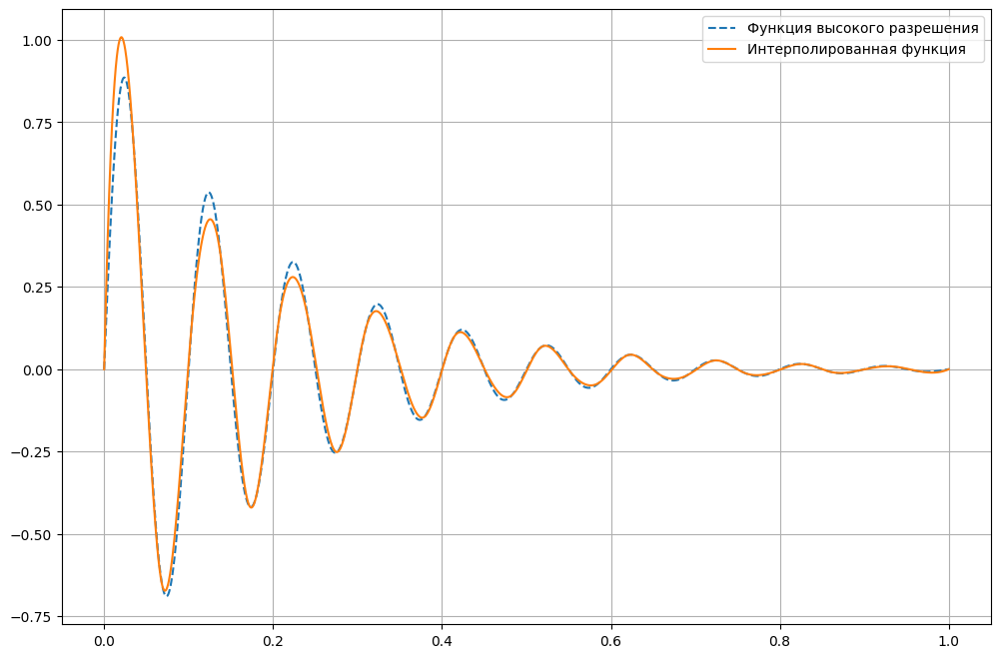

In [34]:
# Интерполяция кубическим сплайном
f_interpolated = interpolate.interp1d(t, y, kind='cubic')
y_interpolated = f_interpolated(tt)

f, ax = plt.subplots(figsize=(12, 8))
ax.plot(tt, y_high_res, '--', label='Функция высокого разрешения')
ax.plot(tt, y_interpolated, label='Интерполированная функция')
ax.legend()
ax.grid()
plt.show()

np.mean((y_interpolated - y_high_res)**2)

MSE =  0.00105


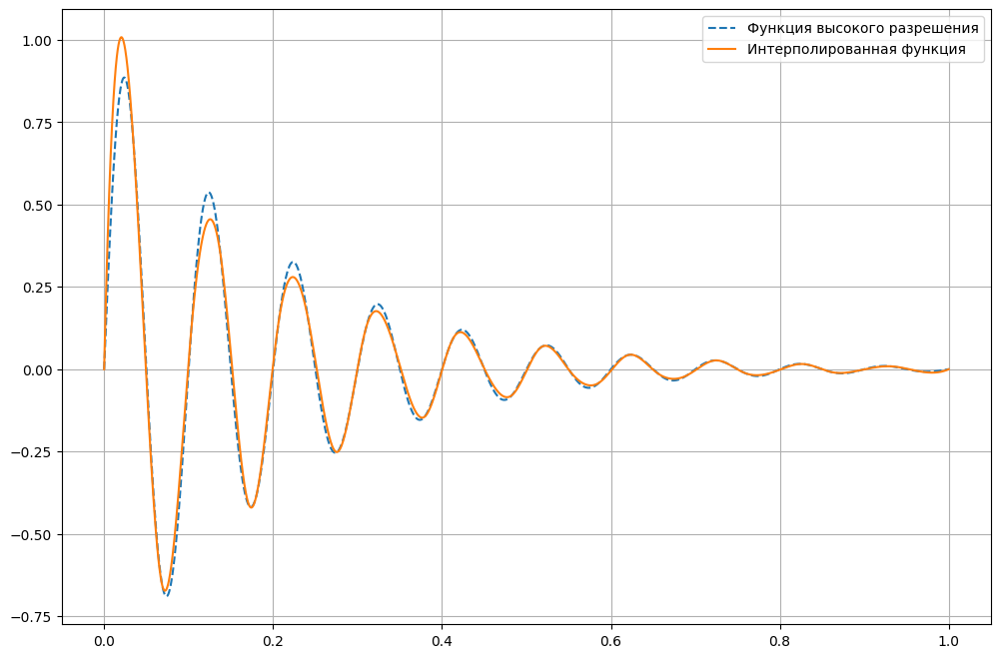

(<matplotlib.legend.Legend at 0x1d647614040>, None, None)

In [42]:
# Интерполяция кубическим сплайном
f_interpolated = interpolate.interp1d(t, y, kind=3)
y_interpolated = f_interpolated(tt)
print('MSE = ', np.round(np.mean((y_interpolated - y_high_res)**2), 5))

f, ax = plt.subplots(figsize=(12, 8))
ax.plot(tt, y_high_res, '--', label='Функция высокого разрешения')
ax.plot(tt, y_interpolated, label='Интерполированная функция')
ax.legend(), ax.grid(), plt.show()

### Задание 8.8.2

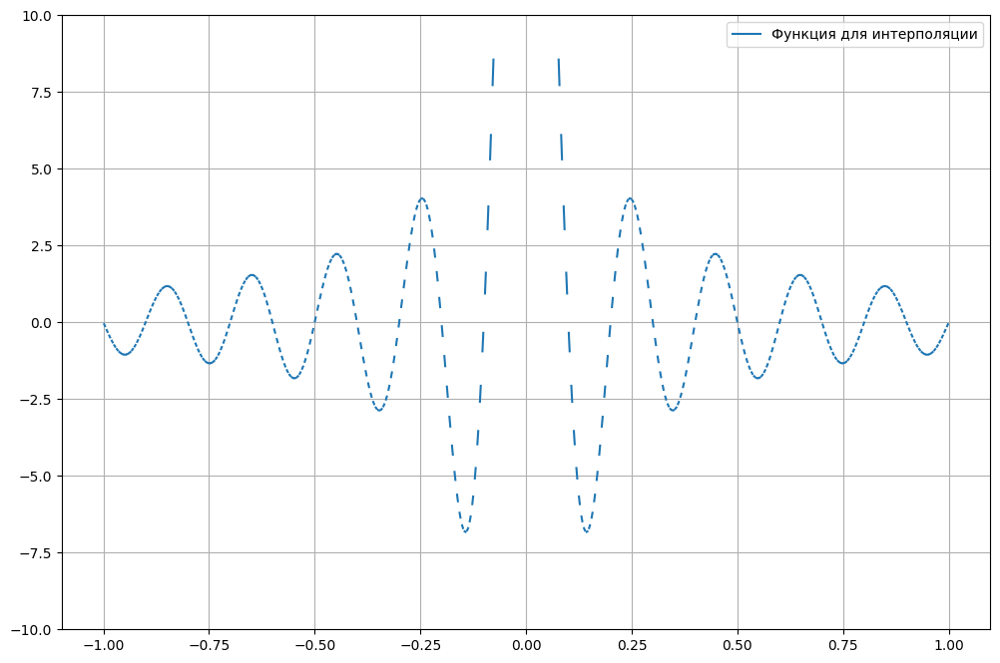

(None, None)

In [44]:
w1 = 5   
a1 = 1     
Fs = 1000
Ts = 1.0/Fs
alpha = 5

df = pd.DataFrame()
## ось
df['t'] = np.linspace(-1, 1, Fs)
## функция для интерполяции
df['y'] = np.sin(2*np.pi*w1*df.t) / df.t 
 
## пропущенные значения    
df['y_lost'] = df.y
df.loc[0::3, 'y_lost'] = np.nan


f, ax = plt.subplots(figsize=(12, 8))
ax.plot(df.t, df.y_lost)
ax.set_ylim([-10, 10])
ax.legend(['Функция для интерполяции'])
ax.grid(), plt.show()

# df.head(10)

MSE =  0.021


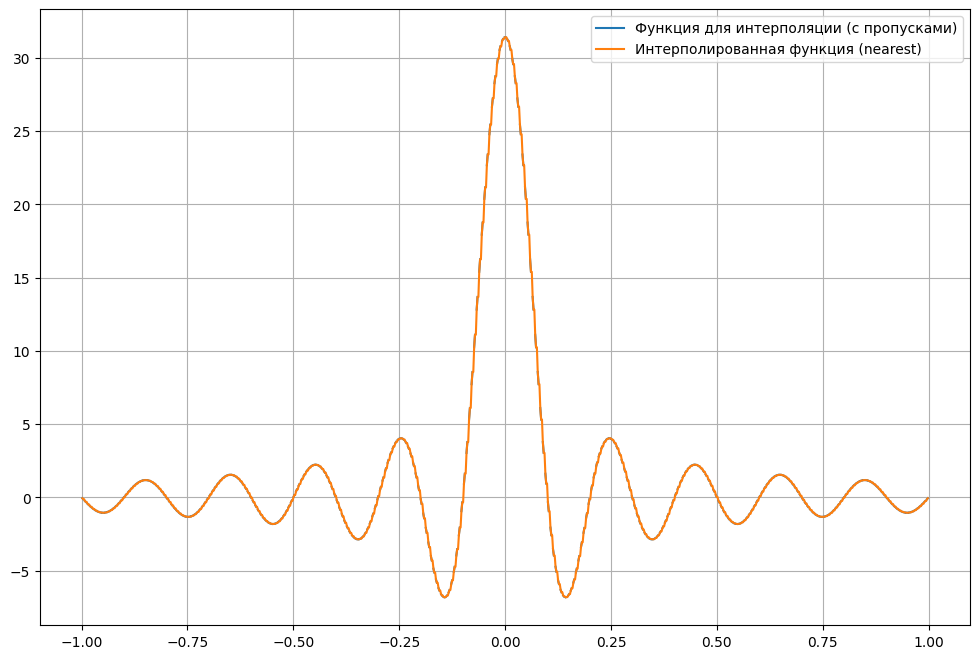

(<matplotlib.legend.Legend at 0x1d669490550>, None, None)

In [47]:
# Интерполяция пропущенных значений методом ближайшего значения
df['y_lost_interpolated'] = df['y_lost'].interpolate(method='nearest')
mse = np.mean((df['y'] - df['y_lost_interpolated'])**2)
print('MSE = ', np.round(mse, 3))

f, ax = plt.subplots(figsize=(12, 8))
ax.plot(df['t'], df['y_lost'], label='Функция для интерполяции (с пропусками)')
ax.plot(df['t'], df['y_lost_interpolated'], label='Интерполированная функция (nearest)')
ax.legend(), ax.grid(), plt.show()

### Задание 8.8.3

MSE =  0.0


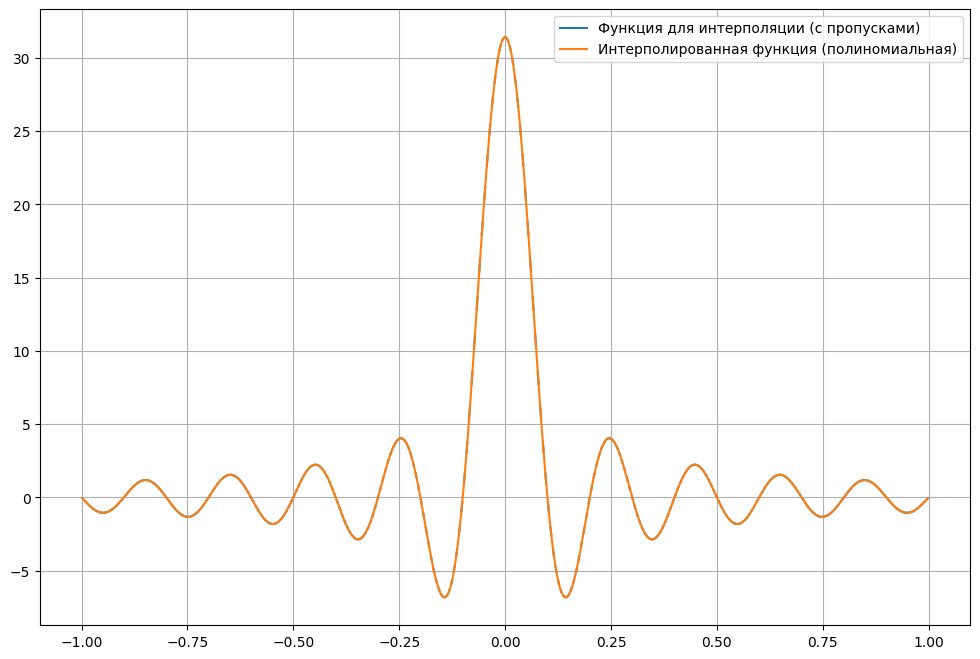

(<matplotlib.legend.Legend at 0x1d66b0b0a30>, None, None)

In [49]:
w1 = 5   
a1 = 1     
Fs = 1000
Ts = 1.0/Fs
alpha = 5

# Создание DataFrame
df = pd.DataFrame()
## ось
df['t'] = np.linspace(-1, 1, Fs)
## функция для интерполяции
df['y'] = np.sin(2*np.pi*w1*df['t']) / df['t']
 
## пропущенные значения    
df['y_lost'] = df['y']
df.loc[0::3, 'y_lost'] = np.nan

# Интерполяция пропущенных значений полиномиальным методом
df['y_lost_interpolated'] = df['y_lost'].interpolate(method='polynomial', order=5)
mse = np.mean((df['y'] - df['y_lost_interpolated'])**2)
print('MSE = ', np.round(mse, 5))

f, ax = plt.subplots(figsize=(12, 8))
ax.plot(df['t'], df['y_lost'], label='Функция для интерполяции (с пропусками)')
ax.plot(df['t'], df['y_lost_interpolated'], label='Интерполированная функция (полиномиальная)')
ax.legend(), ax.grid(), plt.show()

### Задания 8.10.1 - 8.10.5

In [55]:
filePath = './data/EURUSD_1.csv'
data = pd.read_csv(filePath)
data['ts'] = pd.to_datetime(data.ts)
print(f'data.shape = {data.shape}')

data.head()

data.shape = (121674, 6)


,open,high,low,close,vol,ts
0,1.05135,1.05192,1.05134,1.05187,65,2017-01-02 09:00:00
1,1.05185,1.05198,1.05153,1.05168,58,2017-01-02 09:01:00
2,1.05175,1.05201,1.05149,1.05154,33,2017-01-02 09:02:00
3,1.05177,1.05202,1.05177,1.05200,20,2017-01-02 09:03:00
4,1.05202,1.05202,1.05198,1.05202,7,2017-01-02 09:04:00


In [61]:
df = data.copy()

fig = go.Figure(data  = [go.Candlestick(
            x=df['ts'],
            open  = df['open'],
            high  = df['high'],
            low   = df['low'],
            close = df['close']
        )])

fig.show()

In [62]:
# Преобразование столбца 'ts' в формат datetime и установка его в качестве индекса
df['ts'] = pd.to_datetime(df['ts'])
df.set_index('ts', inplace=True)

In [63]:
df_resampled = df.resample('8H').median()
open_price_2017_01_02_16_00 = df_resampled.loc['2017-01-02 16:00:00', 'open']
print("Результирующая цена open в момент времени 2017-01-02 16:00:00:", round(open_price_2017_01_02_16_00, 5))

Результирующая цена open в момент времени 2017-01-02 16:00:00: 1.04649


In [64]:
df_resampled = df.resample('8H').mean()
close_price_2017_01_02_16_00 = df_resampled.loc['2017-01-02 16:00:00', 'close']
print("Результирующая цена close в момент времени 2017-01-02 16:00:00:", round(close_price_2017_01_02_16_00, 5))

Результирующая цена close в момент времени 2017-01-02 16:00:00: 1.04637


In [65]:
df_resampled = df.resample('8H').max()
high_price_2017_01_04_00_00 = df_resampled.loc['2017-01-04 00:00:00', 'high']
print("Результирующая цена high в момент времени 2017-01-04 00:00:00:", round(high_price_2017_01_04_00_00, 5))

Результирующая цена high в момент времени 2017-01-04 00:00:00: 1.04236


In [66]:
df_resampled = df.resample('8H').min()
low_price_2017_01_04_00_00 = df_resampled.loc['2017-01-04 00:00:00', 'low']
print("Результирующая цена low в момент времени 2017-01-04 00:00:00:", round(low_price_2017_01_04_00_00, 5))

Результирующая цена low в момент времени 2017-01-04 00:00:00: 1.03898


In [67]:
df_resampled = df.resample('8H').agg({'vol': ['median', 'mean']})
aggregated_volume = (df_resampled['vol']['median'] + df_resampled['vol']['mean']) / 2
resulting_volume_2017_01_05_08_00 = aggregated_volume.loc['2017-01-05 08:00:00']
rounded_resulting_volume = round(resulting_volume_2017_01_05_08_00, 1)
print("Результирующий объем в момент времени 2017-01-05 08:00:00:", rounded_resulting_volume)

Результирующий объем в момент времени 2017-01-05 08:00:00: 481.3


### Задания 8.10.6 - 8.10.8

In [79]:
df = data.copy()

# Преобразование столбца 'ts' в формат datetime и установка его в качестве индекса
df['ts'] = pd.to_datetime(df['ts'])
df.set_index('ts', inplace=True)

In [68]:
filtered_df = df[df.index <= '2017-01-03 00:00:00']
resampled_df = filtered_df.resample('10S').agg({'open': ['median', 'mean']})
missing_open_data_count = resampled_df['open'].isna().sum()
print("Количество отсутствующих данных в колонке open:", missing_open_data_count)

Количество отсутствующих данных в колонке open: median    4508
mean      4508
dtype: int64


In [85]:
df = data.copy()
# Преобразование столбца 'ts' в формат datetime и установка его в качестве индекса
df['ts'] = pd.to_datetime(df['ts'])
df.set_index('ts', inplace=True)

df['open'] = df['open'].interpolate(method='linear')
open_price  = df.loc['2017-01-02 09:00:40', 'open']
print("Значение цены открытия в 2017-01-02 09:00:40:", round(open_price , 6))

KeyError: '2017-01-02 09:00:40'

In [86]:
df = data.copy()
# Преобразование столбца 'ts' в формат datetime и установка его в качестве индекса
df['ts'] = pd.to_datetime(df['ts'])
df.set_index('ts', inplace=True)

df['close'] = df['close'].interpolate(method='nearest')
close_price = df.loc['2017-01-02 09:00:40', 'close']
print("Значение цены закрытия в 2017-01-02 09:00:40:", round(close_price, 5))

KeyError: '2017-01-02 09:00:40'

### Задание 8.10.9

In [81]:
df = data.copy()
df = df[(df.ts >= '2017-01-05 12:00:00') & (df.ts <= '2017-01-05 13:00:00')]
df['unixtime'] = df.ts.astype(np.int64)

fig = go.Figure(data  = [go.Candlestick(
            x=df['ts'],
            open  = df['open'],
            high  = df['high'],
            low   = df['low'],
            close = df['close']
        )])

fig.show()

df.head()

,open,high,low,close,vol,ts,unixtime
4491,1.05044,1.05052,1.05032,1.05048,530,2017-01-05 12:00:00,1483617600000000000
4492,1.05048,1.05053,1.05031,1.05046,447,2017-01-05 12:01:00,1483617660000000000
4493,1.05046,1.05080,1.05046,1.05075,516,2017-01-05 12:02:00,1483617720000000000
4494,1.05075,1.05093,1.05063,1.05087,477,2017-01-05 12:03:00,1483617780000000000
4495,1.05087,1.05118,1.05087,1.05101,456,2017-01-05 12:04:00,1483617840000000000


In [82]:
grid_unixtime = np.linspace(df['unixtime'].min(), df['unixtime'].max(), 135)
interpolated_close = np.interp(grid_unixtime, df['unixtime'], df['close'])
mean_interpolated_close = np.mean(interpolated_close)
rounded_mean_interpolated_close = round(mean_interpolated_close, 6)
print("Среднее значение интерполированного ряда:", rounded_mean_interpolated_close)

Среднее значение интерполированного ряда: 1.050295
